# **Finding the Two Best Social Media to Advertise in for an FreeCodeCamp learning product**

In this notebook I will analyze the survey respondents for those responses that may help me understand which social media outlet best promotes FreeCodeCamp products. 

The main goal of this notebook: **To determine which social media most responds to respondents' product needs based on the characteristics of specific social media.**

[Social media refers to the means of interactions among people in which they create, share, and/or exchange information and ideas in virtual communities and networks.](https://communications.tufts.edu/marketing-and-branding/social-media-overview/#:~:text=Social%20media%20refers%20to%20the,Instagram%2C%20LinkedIn%20and%20YouTube%20accounts.)

**Key Principles for Social Media Managers:**

Social media is about conversations, community, connecting with the audience and building relationships. It is not just a broadcast channel or a sales and marketing tool.

Authenticity, honesty and open dialogue are key.

Social media not only allows you to hear what people say about you, but enables you to respond. Listen first, speak second.

Be compelling, useful, relevant and engaging. Don’t be afraid to try new things, but think through your efforts before kicking them off.

Specifically in this study, I want to use social media platforms. Such as **Linkedln, Facebook, Instagram, Tiktok**, and **Youtube**. Each of these platforms is most appealing to a certain target audience. By analyzing the characteristics of the TA of these social media and comparing at the end with our results, I will be able to say which social network is best suited for advertising in our case. 



1.  [Linkedln](https://blog.hootsuite.com/linkedin-demographics-for-business/#:~:text=LinkedIn%20is%20the%20biggest%20social,audience%E2%80%94it's%20a%20powerful%20platform.) 

2.   [Facebook](https://sproutsocial.com/insights/facebook-stats-for-marketers/)

3.   [Instagram](https://blog.hootsuite.com/instagram-demographics/)

1.   [Tiktok](https://thesocialshepherd.com/blog/tiktok-statistics#:~:text=Ages%2010%2D19%20are%2025,49%20is%2020.3%25%20of%20users.)
2.   [Youtube](https://www.globalmediainsight.com/blog/youtube-users-statistics/#demographics)


[More detailed visualization of the target audience of each social media ](https://www.pewresearch.org/internet/2021/04/07/social-media-use-in-2021/)

<a href="https://www.pewresearch.org/internet/2021/04/07/social-media-use-in-2021/pi_2021-04-07_social-media_0-03/"><img src="https://www.pewresearch.org/internet/wp-content/uploads/sites/9/2021/04/PI_2021.04.07_social-media_0-03.png?w=640"></a>



**The columns I will use in this research are**
```
'Age', 
'Gender', 
'EmploymentField', 
'EmploymentStatus', 
'ExpectedEarning', 
'Income', 
'JobRoleInterest', 
'LanguageAtHome', 
'MaritalStatus', 
'MoneyForLearning', 
'SchoolDegree', 
'SchoolMajor'
```

I don't need all of the columns to determine which social network is the best place to advertise products. I'm adding some of them for a more accurate portrait of the respondent 

#Read the Data and Exploratory Data Analysis

In [2]:
#Install pandas-profiing for creating a report about dataset

! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip (22.0 MB)


In [34]:
# Read in the data
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
import seaborn as sns
direct_link = 'https://raw.githubusercontent.com/freeCodeCamp/2017-new-coder-survey/master/clean-data/2017-fCC-New-Coders-Survey-Data.csv'
frc = pd.read_csv(direct_link, low_memory = 0) # low_memory = False to silence dtypes warning

# Quick exploration of the data
print(frc.shape)
pd.options.display.max_columns = 150 # to avoid truncated output 


(18175, 136)


In [6]:
#What datatypes columns have
print(frc.dtypes)

Age                    float64
AttendedBootcamp       float64
BootcampFinish         float64
BootcampLoanYesNo      float64
BootcampName            object
                        ...   
YouTubeMIT             float64
YouTubeMozillaHacks    float64
YouTubeOther            object
YouTubeSimplilearn     float64
YouTubeTheNewBoston    float64
Length: 136, dtype: object


In [7]:
#Full report about our dataset
profile = ProfileReport(frc)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

This report clearly shows that we have 70% missing data and zero duplicate data. Some of the columns are not suitable for analysis because there is only one value, or they consist almost entirely of missing data. I will remove the missing data for a more accurate analysis. 

However, this method can not always be used because of the high risk of distortion of the analysis results. I already did the analysis without removing the missing data in another notebook, so I think that in this analysis, I can only rely on the respondents who answered all the questions I need for the analysis

##Data Cleaning

In this chapter I will remove missing data from the whole dataframe

**Missing completely at random**— There are no systematic differences between the missing values and the observed values. For example, blood pressure measurements may be missing because of breakdown of an automatic sphygmomanometer

**Missing at random** — Any systematic difference between the missing values and the observed values can be explained by differences in observed data. For example, missing blood pressure measurements may be lower than measured blood pressures but only because younger people may be more likely to have missing blood pressure measurements

**Missing not at random** — Even after the observed data are taken into account, systematic differences remain between the missing values and the observed values. For example, people with high blood pressure may be more likely to miss clinic appointments because they have headaches
  
[Multiple imputation for missing data in epidemiological and clinical research: potential and pitfalls](https://www.bmj.com/content/338/bmj.b2393)

In [10]:
#Create new dataframe with only nedeed columns

frc = frc[['Age', 'Gender', 'EmploymentField', 'EmploymentStatus', 'ExpectedEarning', 'Income', 'JobRoleInterest', 'LanguageAtHome', 'MaritalStatus', 'MoneyForLearning', 'SchoolDegree', 'SchoolMajor']]

In [11]:
#Check first and last 5 rows

pd.concat([frc.head(3), frc.tail(3)])

,Age,Gender,EmploymentField,EmploymentStatus,ExpectedEarning,Income,JobRoleInterest,LanguageAtHome,MaritalStatus,MoneyForLearning,SchoolDegree,SchoolMajor
0,27.0,female,software development and IT,Employed for wages,NaN,NaN,NaN,English,married or domestic partnership,150.0,"some college credit, no degree",NaN
1,34.0,male,NaN,Not working but looking for work,35000.0,NaN,Full-Stack Web Developer,English,"single, never married",80.0,"some college credit, no degree",NaN
2,21.0,male,software development and IT,Employed for wages,70000.0,13000.0,"Front-End Web Developer, Back-End Web Develo...",Spanish,"single, never married",1000.0,high school diploma or equivalent (GED),NaN
18172,39.0,male,NaN,Employed for wages,NaN,1000000.0,NaN,Zulu,married or domestic partnership,19.0,some high school,NaN
18173,54.0,male,education,Employed for wages,NaN,1000000.0,NaN,English,divorced,0.0,"trade, technical, or vocational training",NaN
18174,50.0,male,health care,Employed for wages,NaN,1000000.0,"Back-End Web Developer, Data Engineer, Data ...",English,married or domestic partnership,NaN,bachelor's degree,Computer and Information Studies


In [12]:
# Check which columns have missing values 

frc.isnull().sum()

Age                  2808
Gender               2721
EmploymentField     10059
EmploymentStatus     3830
ExpectedEarning     10975
Income              10552
JobRoleInterest     11183
LanguageAtHome       2831
MaritalStatus        2840
MoneyForLearning     1598
SchoolDegree         2807
SchoolMajor          9448
dtype: int64

In [16]:
# Delete rows with missing values

frc.dropna(subset = ['Age', 'Gender', 'EmploymentField', 'EmploymentStatus', 'ExpectedEarning', 'Income', 'JobRoleInterest', 'LanguageAtHome', 'MaritalStatus', 'MoneyForLearning', 'SchoolDegree', 'SchoolMajor'], inplace=True)

/usr/local/lib/python3.7/dist-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [17]:
# Check which columns have missing values again

frc.isnull().sum()

Age                 0
Gender              0
EmploymentField     0
EmploymentStatus    0
ExpectedEarning     0
Income              0
JobRoleInterest     0
LanguageAtHome      0
MaritalStatus       0
MoneyForLearning    0
SchoolDegree        0
SchoolMajor         0
dtype: int64

In [30]:
# Check how many columns and rows now in DataFrame

frc.shape

(1360, 12)

##Respondent characteristics

In this section, I'll take a closer look at the columns we need for analysis to understand our respondents

###Age and Gender

In [73]:
# The average age of a responder is 27-28 years old

frc['Age'].mean()

27.691872193661744

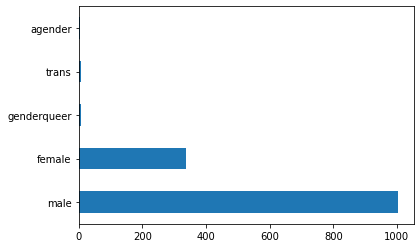

In [32]:
# The most common gender is male

frc['Gender'].value_counts().plot(kind='barh')

In [27]:
# Let's see the correlation of age and gender

pd.set_option("display.max_rows", None)
frc.groupby('Age')['Gender'].value_counts().to_frame()

Gender
Age Gender             
18  male              1
20  male              4
21  male              9
    female            6
22  male             33
    female           13
    agender           1
23  male             52
    female           12
    genderqueer       1
    trans             1
24  male             51
    female           22
    trans             1
25  male             67
    female           28
    trans             1
26  male             83
    female           23
    genderqueer       2
    trans             1
27  male             72
    female           27
    trans             3
    agender           1
    genderqueer       1
28  male             63
    female           24
29  male             68
    female           27
    genderqueer       2
    agender           1
30  male             65
    female           19
    agender           1
31  male             37
    female           11
32  male             55
    female           18
    genderqueer       2
33  male             52
    female           15
34  male             46
    female           12
    trans             1
35  male             34
    female            9
36  male             36
    female            2
37  male             20
    female           11
38  male             14
    female            5
39  male             23
    female            4
40  male             15
    female            7
41  male             13
    female            5
42  male              9
    female            3
43  male             10
    female            4
44  male             12
    female            3
45  male              7
    female            5
46  female            2
    male              1
47  female            7
    male              5
48  male              8
    female            3
49  male              6
    female            1
50  male              7
    female            1
51  male              1
52  male              4
    female            1
53  male              5
54  male              2
    female            1
55  female            1
56  female            1
57  male              1
58  male              3
59  male              2
    female            1
60  female            2
    male              1
61  male              2
    female            1
62  male              1
65  male              1
69  female            1
70  male              1

###Education and Work

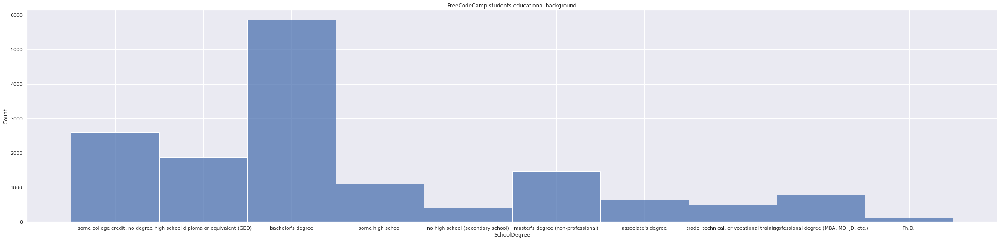

In [45]:
# The most common education is college or a bachelor's degree

sns.set(style="darkgrid")
plt.figure(figsize=(40,9))
sns.histplot(data=frc, x="SchoolDegree")
plt.title("FreeCodeCamp students educational background")
plt.show()

In [75]:
# The respondent most likely has a degree in engineering or economics.

frc["SchoolMajor"].value_counts(10)

Computer Science                          0.154119
Information Technology                    0.043772
Electrical and Electronics Engineering    0.032543
Economics                                 0.024178
Computer Software Engineering             0.023490
                                            ...   
Forestry                                  0.000115
Forensic Science                          0.000115
Industrial Production Technician          0.000115
Child Development                         0.000115
Occupational Therapy                      0.000115
Name: SchoolMajor, Length: 472, dtype: float64

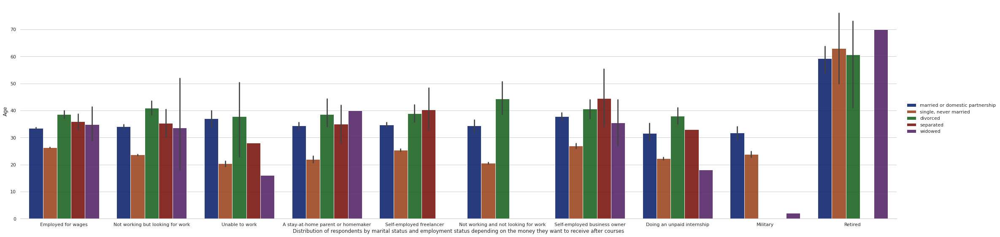

In [48]:
# Correlation of work status, marital status, and age

sns.set_theme(style="whitegrid", palette="pastel")

g = sns.catplot(
    data=frc, kind="bar",
    x="EmploymentStatus", y="Age", hue="MaritalStatus",
    palette="dark", alpha=.9, height=8, aspect=30/8
)
g.despine(left=True)
g.set_axis_labels("Distribution of respondents by marital status and employment status depending on the money they want to receive after courses")
g.legend.set_title("")

In [49]:
# Place of work varies greatly, but technical professions predominate

frc['EmploymentField'].value_counts()

software development and IT              4721
education                                 626
sales                                     415
food and beverage                         386
arts, entertainment, sports, or media     372
office and administrative support         361
health care                               325
finance                                   264
architecture or physical engineering      202
transportation                            167
construction and extraction               129
legal                                      70
law enforcement and fire and rescue        40
farming, fishing, and forestry             38
Name: EmploymentField, dtype: int64

###Money for leaving and learning

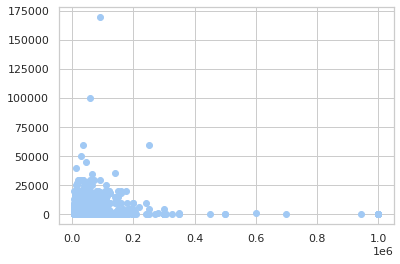

In [72]:
# There is no exact correlation between the money allocated for additional training and earnings

y = frc['MoneyForLearning']
x = frc['Income']

plt.scatter(x, y)
plt.show()

In [76]:
# Earnings not exceeding $70,000 a year

frc['Income'].value_counts(20)

60000.0    0.057195
30000.0    0.051686
20000.0    0.045520
10000.0    0.044602
12000.0    0.040929
             ...   
37440.0    0.000131
24950.0    0.000131
7386.0     0.000131
35500.0    0.000131
12060.0    0.000131
Name: Income, Length: 585, dtype: float64

###Other

In [55]:
# Respondents are most interested in web development (front and back) and least interested in various IT areas in equal proportion

pd.set_option("display.max_rows", 20)
frc['JobRoleInterest'].value_counts().to_frame()

,JobRoleInterest
Full-Stack Web Developer,823
Front-End Web Developer,450
Data Scientist,152
Back-End Web Developer,142
Mobile Developer,117
...,...
"Front-End Web Developer, DevOps / SysAdmin, Mobile Developer, Full-Stack Web Developer",1
"Back-End Web Developer, Front-End Web Developer, Data Engineer, Full-Stack Web Developer, Mobile Developer",1
"Back-End Web Developer, User Experience Designer, Mobile Developer, Game Developer, Front-End Web Developer, Full-Stack Web Developer",1
"Front-End Web Developer, Mobile Developer, Back-End Web Developer, Full-Stack Web Developer, Data Engineer",1


In [50]:
# Most often the respondent speaks English, Spanish, or Russian, which coincides with the distribution of native speakers around the world

frc['LanguageAtHome'].value_counts()

English                      7124
Spanish                      1035
Hindi                         611
Russian                       563
Portuguese                    489
French                        320
Polish                        298
German                        275
Arabic                        240
Romanian                      210
Telugu                        181
Italian                       171
Bengali                       159
Serbian                       150
Chinese                       147
Tamil                         144
Tagalog                       132
Greek                         132
Dutch                         130
Urdu                          128
Turkish                       127
Vietnamese                    117
Ukrainian                     116
Marathi                       111
Gujarati                      101
Malayalam                      98
Hungarian                      97
Indonesian                     87
Mandarin Chinese               76
Croatian      

##Conclusions

After analyzing the target audiences of the above social networks and comparing them with our result, I can confidently say that the three best social networks for advertising are **LinkedIn**, **YouTube** and **Facebook**

Also, based on the fact that respondents most often speak English and live in the U.S. or India, YouTube and Facebook are preferred. 

LinkedIn is suitable for long-storytelling ads with personal success stories, certificate marking. But it's not very suitable for video ads and training content. 

YouTube is best suited for training content, video reviews, product test drives, advertising inside YouTube

Facebook is best for banner ads, video ads, targeting. 

For a more accurate analysis, I will continue to study social media using their dataframes and subsequently, make a more in-depth study, where I will use the actual data at a particular moment